# Installing necessary stuff

In [1]:
!pip install rioxarray eemont rasterio geopy geemap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.7/134.7 kB 2.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.7/224.7 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.9/61.9 kB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 16.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 17.7 MB/s eta 0:00:00
  Created wheel for eemont: filename=eemont-0.3.6-py3-none-any.whl size=135742 sha256=c546741c66ae32cb56cc30c0d7f86e647cfbf2cee8e1e4b4b1c75cbe68484bd9
  Stored in directory: /root/.cache/pip/wheels/c2/79/2c/4fed17c3d3b466bbf4fe5872eec11f189147043b01152a4f75
  Created wheel for ee_extra: filename=ee_extra-0.0.15-py3-none-any.whl size=236753 sha256=e4914057386fb86e790210c9b9219be6c2b2e188ac69a84c02bf788b5f3a0938
  Stored in directory: /root/.cache/pip/wheels/29/96/0e/4e36b0dfd85e16867723df739294c0aa45a65b191adac4d959

In [2]:
import getpass
from datetime import datetime
from pathlib import Path

import requests
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
from ipyleaflet import GeoJSON, Map, basemaps

In [3]:
# Import Libraries

import ee  # Google Earth Engine
import eemont  # Extension to Google Earth Engine
import geemap

from PIL import Image
import rasterio
import geopy
import geopy.distance

In [4]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# Sentinel-2 using Google Earth Engine API

Let's see a temporal change of forest cover. Originally, our pixel has some spatial resolution (could be 60x60m, 100x100m) so we can convert it to km2 for easier undesrtanding.

The first step of using Google Earth Engine is to authenticate your session, which can be done interactively in a jupyter notebook by running the following command.

However, you can't simply open Earth Engine and work. You need to [set up](https://code.earthengine.google.com/register) a project in it and initialize it.

In [78]:
ee.Authenticate()
ee.Initialize(project='govtechdesign2024')

**Setting an Area of Interest (AOI)**

The bounding box in WGS84 coordinate system is **[(lon, lat) of bottom left and (lon lat) of top right corners]*. You can get the bbox for a different area at the bboxfinder website [here](http://bboxfinder.com/) .

Resolution defines spatial resolution of a single pixel in meters. The smaller the value, the heavier would be your image (and there's a limit on that in API). Ideally, keep it within 20~100m. Sentinel-2 has native spatial resolution of 10m and 60m.

Also, depending on the region of study, you might want to use a different georeference system. By default, Mercator projection (EPSG:4326) is used. However, for Amazon rainforest, EPSG:32720 may be a better choice. Nevertheless, we will need to transform back to EPSG:4326 for mapping.

For your convenience, there are several bounding boxes available to try out. They display different patterns of deforestation that occurs, be it as a result of logging, gold mining, etc:


*   Logging (Iquiri National Forest, Brazil): [-66.92282407607523, -8.931435895156712, -66.48360080471075, -8.407729817732529]
*   Gold Mining (Madre de Dios, Peru): [-70.68274496750519, -13.067138507940329, -70.24352169614071, -12.543432430516147]
*   Farming (State of Mato Grosso, Brazil): [-58.70600039147012,-12.135915102857704, -58.18229431404594, -11.696691831493224]
*   Oil Drilling (Yasuni National Forest, Equador): [-75.82837255682252, -1.063537345418459, -75.30466647939834, -0.624314073953979]



**Quantifying Deforestation**

From what we can see, there clearly are areas where over the years NDVI decreases in a somewhat organized fashion. To make sure, let's create a new band called FOREST which is binary coded (1 if NDVI > 0.6, 0 if not). Generally, this provides about 80% accuracy compared to validation dataset, so it is a good start to capture spatiotemporal trends.

To determine the annual forest cover, we can compile all monthly data available in each year, classify forest in it and estimate mean value of FOREST per pixel. For instance, if some pixel had FOREST values of *[0 0 1 1 NaN 1 NaN], it means that this year its FOREST value is 1.

Then, comparison between two years is rather trivial where we subtract one forest map from the other and color-code the change. It can take three possible values: -1 (deforested), 0 (no change), +1 (forest gained).

In many cases, data may appear "dirty" in a way due to the cloud cover. Various datasets have already implemented a cloud masking layer that works with varying levels of efficiency. Thus, we can consider image stacking - basically, compare datasets and fill in the missing details of main one with supplementary.

Here, we will assume Sentinel-2 to be the main dataset as it has the best resolution. Then, we will fill in the gaps, wherever possible, with Landsat-7 and Landsat-8.

In [79]:
#@title Single Year Data Stacking

def scale_landsat(image):
    optical_bands = image.select(['SR_B1', 'SR_B2', 'SR_B3', 'SR_B4', 'SR_B5'])
    scaled = optical_bands.multiply(2.75e-5).add(-0.2)
    return image.addBands(scaled, overwrite=True)

def mask_landsat_clouds(image):
    qa = image.select('QA_PIXEL')
    cloud_mask = qa.bitwiseAnd(1 << 3).eq(0).And(qa.bitwiseAnd(1 << 5).eq(0))
    return image.updateMask(cloud_mask)

# Mask and scale Sentinel-2 data
def mask_s2_clouds(image):
    # Check the image's date
    image_date = ee.Date(image.get('system:time_start'))

    # For years before 2022, use QA60
    def mask_pre_2021():
        qa = image.select('QA60')
        cloud_bit_mask = 1 << 10
        cirrus_bit_mask = 1 << 11
        return qa.bitwiseAnd(cloud_bit_mask).eq(0).And(qa.bitwiseAnd(cirrus_bit_mask).eq(0))

    # For 2022 and 2023, use SCL (Scene Classification Layer)
    def mask_post_2021():
        scl = image.select('SCL')
        # Mask out cloud classes: 7 (low probability clouds), 8 (medium probability),
        # 9 (high probability clouds), 10 (cirrus)
        cloud_mask = scl.lt(7).Or(scl.gt(10))
        return cloud_mask

    # Conditional masking based on date
    cloud_mask = ee.Algorithms.If(
        image_date.format('YYYY').compareTo('2021').lt(0),
        mask_pre_2021(),
        mask_post_2021()
    )

    return image.updateMask(cloud_mask)

def scale_sentinel_image(image):
    return image.multiply(0.0001)

# Process Landsat and Sentinel data
def process_landsat(year, landsat_collection):
    if landsat_collection == 'LANDSAT/LC08/C02/T1_L2':  # Landsat-8
        bands = ['SR_B4', 'SR_B3', 'SR_B2']
        nir_band, red_band = 'SR_B5', 'SR_B4'
    elif landsat_collection == 'LANDSAT/LE07/C02/T1_L2':  # Landsat-7
        bands = ['SR_B3', 'SR_B2', 'SR_B1']
        nir_band, red_band = 'SR_B4', 'SR_B3'
    else:
        raise ValueError(f"Unsupported Landsat collection: {landsat_collection}")

    collection = (
        ee.ImageCollection(landsat_collection)
        .filterBounds(roi)
        .filterDate(f'{year}-01-01', f'{year}-12-31')
        .map(mask_landsat_clouds)
        .map(scale_landsat)
    )

    size = collection.size().getInfo()
    print(f"{landsat_collection} collection size for {year}: {size}")

    if size == 0:
        return None, None

    composite = collection.median()
    true_color = composite.select(bands, ['Red', 'Green', 'Blue'])
    ndvi = composite.normalizedDifference([nir_band, red_band]).rename(['NDVI'])
    return true_color, ndvi

def process_sentinel(year):
    collection = (
        ee.ImageCollection('COPERNICUS/S2_SR')
        .filterBounds(roi)
        .filterDate(f'{year}-01-01', f'{year}-12-31')
        .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
        .map(mask_s2_clouds)
        .map(scale_sentinel_image)
    )

    # Select only the necessary bands before calculating median
    collection = collection.select(['B4', 'B3', 'B2', 'B8'])  # Select Red, Green, Blue, and NIR bands

    size = collection.size().getInfo()
    print(f"Sentinel-2 collection size for {year}: {size}")

    if size == 0:
        return None, None

    composite = collection.median()  # Calculate median after selecting bands
    true_color = composite.select(['B4', 'B3', 'B2'], ['Red', 'Green', 'Blue'])
    ndvi = composite.normalizedDifference(['B8', 'B4']).rename(['NDVI'])
    return true_color, ndvi

def combine_true_color_images(sentinel_true, landsat8_true, landsat7_true):
    """
    Combines true color images from Sentinel-2, Landsat-8, and Landsat-7 in priority order.
    Sentinel-2 > Landsat-8 > Landsat-7.
    """
    # Start with Sentinel-2 if available
    combined_true = sentinel_true if sentinel_true is not None else None

    # Fill gaps with Landsat-8 where Sentinel-2 is missing
    if landsat8_true is not None:
        if combined_true is not None:
            combined_true = combined_true.where(combined_true.mask().Not(), landsat8_true)
        else:
            combined_true = landsat8_true

    # Fill remaining gaps with Landsat-7
    if landsat7_true is not None:
        if combined_true is not None:
            combined_true = combined_true.where(combined_true.mask().Not(), landsat7_true)
        else:
            combined_true = landsat7_true

    return combined_true

# Combining True Color and Adding to Map
def process_and_combine_data(year):
    """
    Process data for the given year and combine datasets in priority order.
    Includes true color, NDVI, and forest classification layers.
    """
    print(f"Processing data for year {year}...")

    # Process datasets
    sentinel_true, sentinel_ndvi = process_sentinel(year)
    landsat8_true, landsat8_ndvi = process_landsat(year, 'LANDSAT/LC08/C02/T1_L2')
    landsat7_true, landsat7_ndvi = process_landsat(year, 'LANDSAT/LE07/C02/T1_L2')

    # Combine true color images
    combined_true = combine_true_color_images(sentinel_true, landsat8_true, landsat7_true)

    # Combine NDVI images
    ndvi_list = [img for img in [landsat8_ndvi, landsat7_ndvi, sentinel_ndvi] if img is not None]
    combined_ndvi = ee.ImageCollection(ndvi_list).max() if ndvi_list else None

    # Create forest classification
    forest_layer = classify_forest(combined_ndvi)

    return combined_true, combined_ndvi, forest_layer

def classify_forest(ndvi_image):
    """Classify pixels as forest (1) if NDVI > 0.6, else non-forest (0)."""
    if ndvi_image is None:
        return None
    return ndvi_image.gt(0.65).rename('FOREST')

# Input Definitions
roi = ee.Geometry.Rectangle([-66.92282407607523, -8.931435895156712, -66.48360080471075, -8.407729817732529])
year = 2023
combined_true, combined_ndvi, forest_layer = process_and_combine_data(year)

# Visualization parameters
# Visualization parameters
true_color_vis_params = {'min': 0, 'max': 0.3, 'gamma': 1.4}
ndvi_vis_params = {'min': 0, 'max': 1.0, 'palette': ['purple', 'white', 'green']}
forest_vis_params = {'min': 0, 'max': 1, 'palette': ['white', 'green']}

# Display the combined result
map_single = geemap.Map()
map_single.centerObject(roi, 10)

# Add True Color imagery over the entire dataset
if combined_true:
    map_single.addLayer(combined_true, true_color_vis_params, f'Combined True Color {year}')

# Clip NDVI and forest layers to ROI
if combined_ndvi:
    map_single.addLayer(combined_ndvi.clip(roi), ndvi_vis_params, f'Combined NDVI {year}')
if forest_layer:
    map_single.addLayer(forest_layer.clip(roi), forest_vis_params, f'Forest Classification {year}')

# Overlay ROI boundary using a black line
roi_outline = ee.Image().byte().paint(featureCollection=roi, color=1, width=2)
roi_vis_params = {'palette': ['black']}
map_single.addLayer(roi_outline, roi_vis_params, 'ROI Boundary')

# Display map
map_single



Processing data for year 2023...
Sentinel-2 collection size for 2023: 60
LANDSAT/LC08/C02/T1_L2 collection size for 2023: 19
LANDSAT/LE07/C02/T1_L2 collection size for 2023: 22


Map(center=[-8.669584746165649, -66.70321244039373], controls=(WidgetControl(options=['position', 'transparent…

In [81]:
#@title Comparison of two selected years

# Combine Landsat and Sentinel NDVI
def combine_ndvi(year):
    sentinel_true, sentinel_ndvi = process_sentinel(year)
    landsat8_true, landsat8_ndvi = process_landsat(year, 'LANDSAT/LC08/C02/T1_L2')
    landsat7_true, landsat7_ndvi = process_landsat(year, 'LANDSAT/LE07/C02/T1_L2')

    true_color_images = [img for img in [sentinel_true, landsat8_true, landsat7_true] if img is not None]
    combined_true = ee.ImageCollection(true_color_images).mosaic() if true_color_images else None

    ndvi_images = [img for img in [landsat8_ndvi, landsat7_ndvi, sentinel_ndvi] if img is not None]
    combined_ndvi = ee.ImageCollection(ndvi_images).max() if ndvi_images else None

    return sentinel_true, landsat8_true, sentinel_ndvi, combined_ndvi

# Calculate annual NDVI
def calculate_annual_ndvi(year, roi):
    print(f"\nProcessing NDVI data for year {year}...")
    _, _, _, combined_ndvi = combine_ndvi(year)
    if combined_ndvi is None:
        print(f"Warning: No NDVI data available for year {year}")
        return None
    return combined_ndvi.clip(roi)

# Function to Analyze Forest Change
def analyze_forest_change(roi, year1, year2):
    # Process NDVI for both years
    ndvi_year1 = calculate_annual_ndvi(year1, roi)
    ndvi_year2 = calculate_annual_ndvi(year2, roi)

    if ndvi_year1 is None or ndvi_year2 is None:
        print("Error: Missing NDVI data for one or both years")
        return None, None, None, None, None

    # Classify forest based on NDVI threshold
    forest_year1 = classify_forest(ndvi_year1)
    forest_year2 = classify_forest(ndvi_year2)

    # Calculate forest change
    forest_change = forest_year2.subtract(forest_year1).rename('FOREST_CHANGE')

    return ndvi_year1, ndvi_year2, forest_year1, forest_year2, forest_change

# Display Results
def display_forest_analysis_and_save_tifs(roi, year1, year2):
    # Initialize map
    m = geemap.Map()
    m.centerObject(roi, 10)

    # Analyze forest change
    ndvi_year1, ndvi_year2, forest_year1, forest_year2, forest_change = analyze_forest_change(roi, year1, year2)
    combined_true1, _, _ = process_and_combine_data(year1)
    combined_true2, _, _ = process_and_combine_data(year2)
    # Visualization Parameters
    vis_params = {
        'true_color': {'min': 0, 'max': 0.3, 'gamma': 1.4},
        'ndvi': {'min': 0, 'max': 1, 'palette': ['purple', 'white', 'green']},
        'forest': {'min': 0, 'max': 1, 'palette': ['FFFFFF', '00FF00']},
        'change': {'min': -1, 'max': 1, 'palette': ['FF0000', 'FFFFFF', '0000FF']}
    }

    # Add Layers to Map
    if combined_true1:
        m.addLayer(combined_true1, vis_params['true_color'], f'True Color {year1}')
    if ndvi_year1:
        m.addLayer(ndvi_year1.clip(roi), vis_params['ndvi'], f'NDVI {year1}')
    if ndvi_year2:
        m.addLayer(ndvi_year2.clip(roi), vis_params['ndvi'], f'NDVI {year2}')
    if forest_year1:
        m.addLayer(forest_year1.clip(roi), vis_params['forest'], f'Forest {year1}')
    if forest_year2:
        m.addLayer(forest_year2.clip(roi), vis_params['forest'], f'Forest {year2}')
    if forest_change:
        m.addLayer(forest_change.clip(roi), vis_params['change'], f'Forest Change {year2}-{year1}')

    # Overlay ROI Boundary
    roi_outline = ee.Image().byte().paint(featureCollection=roi, color=1, width=2)
    roi_vis_params = {'palette': ['black']}
    m.addLayer(roi_outline, roi_vis_params, 'ROI Boundary')

    return m

# Compare Years and Save NDVI as TIFs
year1 = 2020
year2 = 2023
map_display = display_forest_analysis_and_save_tifs(roi, year1, year2)

map_display


Processing NDVI data for year 2020...
Sentinel-2 collection size for 2020: 66
LANDSAT/LC08/C02/T1_L2 collection size for 2020: 15
LANDSAT/LE07/C02/T1_L2 collection size for 2020: 16

Processing NDVI data for year 2023...
Sentinel-2 collection size for 2023: 60
LANDSAT/LC08/C02/T1_L2 collection size for 2023: 19
LANDSAT/LE07/C02/T1_L2 collection size for 2023: 22
Processing data for year 2020...
Sentinel-2 collection size for 2020: 66
LANDSAT/LC08/C02/T1_L2 collection size for 2020: 15
LANDSAT/LE07/C02/T1_L2 collection size for 2020: 16
Processing data for year 2023...
Sentinel-2 collection size for 2023: 60
LANDSAT/LC08/C02/T1_L2 collection size for 2023: 19
LANDSAT/LE07/C02/T1_L2 collection size for 2023: 22


Map(center=[-8.669584746165649, -66.70321244039373], controls=(WidgetControl(options=['position', 'transparent…

Processing year 2001...

Processing NDVI data for year 2001...
Sentinel-2 collection size for 2001: 0
LANDSAT/LC08/C02/T1_L2 collection size for 2001: 0
LANDSAT/LE07/C02/T1_L2 collection size for 2001: 15
Processing year 2002...

Processing NDVI data for year 2002...
Sentinel-2 collection size for 2002: 0
LANDSAT/LC08/C02/T1_L2 collection size for 2002: 0
LANDSAT/LE07/C02/T1_L2 collection size for 2002: 16
Processing year 2003...

Processing NDVI data for year 2003...
Sentinel-2 collection size for 2003: 0
LANDSAT/LC08/C02/T1_L2 collection size for 2003: 0
LANDSAT/LE07/C02/T1_L2 collection size for 2003: 10
Processing year 2004...

Processing NDVI data for year 2004...
Sentinel-2 collection size for 2004: 0
LANDSAT/LC08/C02/T1_L2 collection size for 2004: 0
LANDSAT/LE07/C02/T1_L2 collection size for 2004: 15
Processing year 2005...

Processing NDVI data for year 2005...
Sentinel-2 collection size for 2005: 0
LANDSAT/LC08/C02/T1_L2 collection size for 2005: 0
LANDSAT/LE07/C02/T1_L2 coll

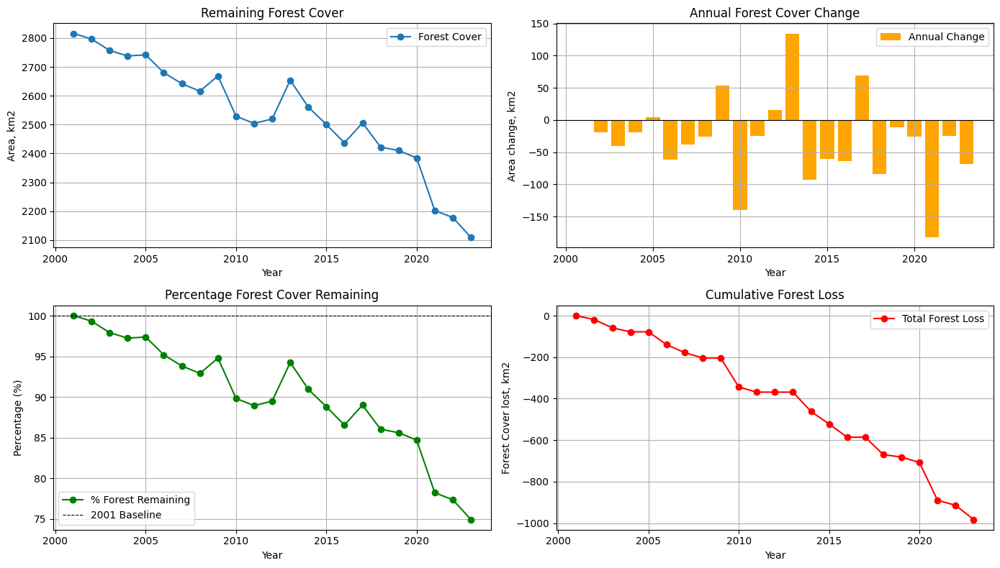

In [84]:
#@title Time Series Analysis for 2001~2023
def classify_forest(ndvi_image):
    """Classify pixels as forest (1) if NDVI > 0.7, else non-forest (0)."""
    if ndvi_image is None:
        return None
    return ndvi_image.gt(0.7).rename('FOREST')

def calculate_forest_cover(year, roi):
    """Calculate the total forest tile count for a given year."""
    # Get the NDVI for the year
    ndvi = calculate_annual_ndvi(year, roi)
    if ndvi is None:
        print(f"No data available for year {year}")
        return 0  # Treat missing data as zero forest cover

    # Classify forest
    forest = classify_forest(ndvi)

    # Count the number of pixels classified as forest
    forest_tile_count = forest.reduceRegion(
        reducer=ee.Reducer.sum(),
        geometry=roi,
        scale=30,  # Scale appropriate for Landsat
        maxPixels=1e9
    ).get('FOREST')

    return ee.Number(forest_tile_count).getInfo() if forest_tile_count is not None else 0

def analyze_forest_trends(start_year, end_year, roi):
    """Analyze forest trends over a range of years."""
    forest_cover = []
    for year in range(start_year, end_year + 1):
        print(f"Processing year {year}...")
        forest_count = calculate_forest_cover(year, roi)
        forest_cover.append(forest_count)

    # Calculate metrics
    forest_cover = np.array(forest_cover) * 0.0009
    annual_change = np.diff(forest_cover, prepend=forest_cover[0])
    percentage_remaining = (forest_cover / forest_cover[0]) * 100

    # Accumulate loss year-by-year
    total_loss = np.zeros_like(annual_change, dtype=float)
    total_loss[0] = min(annual_change[0], 0)  # Initialize with first year's loss
    for i in range(1, len(annual_change)):
        total_loss[i] = total_loss[i - 1] + min(annual_change[i], 0)

    return {
        "years": np.arange(start_year, end_year + 1),
        "forest_cover": forest_cover,
        "annual_change": annual_change,
        "percentage_remaining": percentage_remaining,
        "total_loss": total_loss
    }

def visualize_forest_trends(results):
    """Visualize forest trends using matplotlib."""
    years = results["years"]
    forest_cover = results["forest_cover"]
    annual_change = results["annual_change"]
    percentage_remaining = results["percentage_remaining"]
    total_loss = results["total_loss"]

    plt.figure(figsize=(14, 8))

    # Plot remaining forest cover
    plt.subplot(2, 2, 1)
    plt.plot(years, forest_cover, marker='o', label="Forest Cover")
    plt.title("Remaining Forest Cover")
    plt.xlabel("Year")
    plt.ylabel("Area, km2")
    plt.grid(True)
    plt.legend()

    # Plot annual forest change
    plt.subplot(2, 2, 2)
    plt.bar(years, annual_change, color='orange', label="Annual Change")
    plt.axhline(0, color='black', linewidth=0.8)
    plt.title("Annual Forest Cover Change")
    plt.xlabel("Year")
    plt.ylabel("Area change, km2")
    plt.grid(True)
    plt.legend()

    # Plot percentage remaining
    plt.subplot(2, 2, 3)
    plt.plot(years, percentage_remaining, marker='o', color='green', label="% Forest Remaining")
    plt.axhline(100, color='black', linestyle='--', linewidth=0.8, label=f"{start_year} Baseline")
    plt.title("Percentage Forest Cover Remaining")
    plt.xlabel("Year")
    plt.ylabel("Percentage (%)")
    plt.grid(True)
    plt.legend()

    # Plot total forest loss
    plt.subplot(2, 2, 4)
    plt.plot(years, total_loss, marker='o', color='red', label="Total Forest Loss")
    plt.title("Cumulative Forest Loss")
    plt.xlabel("Year")
    plt.ylabel("Forest Cover lost, km2")
    plt.grid(True)
    plt.legend()

    plt.tight_layout()
    plt.show()

# Example usage:
start_year = 2001
end_year = 2023
roi = ee.Geometry.Rectangle([-66.92282407607523, -8.931435895156712, -66.48360080471075, -8.407729817732529])

# Analyze forest trends and visualize results
forest_trends = analyze_forest_trends(start_year, end_year, roi)
visualize_forest_trends(forest_trends)


You can see the resulting time series analysis from all the years here. Generally, you can notice that

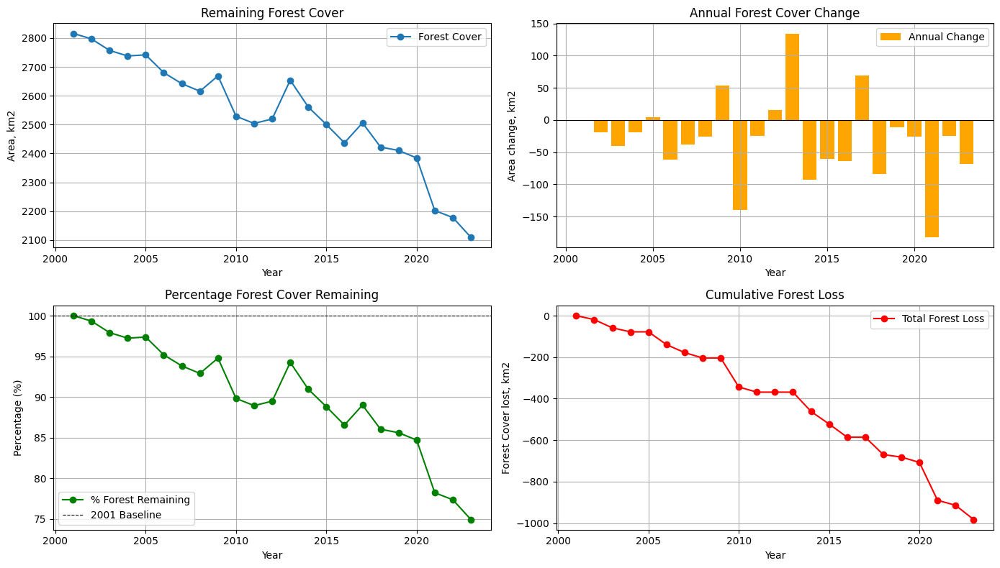

Caution: providing a large or complex collection as the geometry argument can result in poor performance. Collating the geometry of collections does not scale well; use the smallest collection (or geometry) that is required to achieve the desired outcome.

It is generally a good idea to use simple geometry. In case you would like to expand on the bounds, you can always comment out .filterBounds from collections. In that case, ALL available images will be uploaded near the study area.

# Processing Data (locally)

**Saving TIF files locally**

Sometimes, we may need to access the files locally (for instance, when working on a cluster or pairing with some dataset that is not available in Google Earth Engine). In that case, we can actually download a portion of the desired dataset in the form of .tif files!

TIF file is sorta a mix between a traditional image file that contains bands of data. This allows us to encode several layers of data (for exmaple, both RGB and NDVI) within the same file.

In Google Earth Engine, we only need to define ROI, timeslot and resolution in order to request an image.

In [ ]:
#@title Concurrent Data Download
from concurrent.futures import ThreadPoolExecutor, as_completed
from pathlib import Path

# Define the data folder
data_folder = Path("./data")
data_folder.mkdir(exist_ok=True)  # Ensure the data directory exists

def request_output_path(filename):
    return data_folder / filename

def export_multiband_image(image, filename, region, scale=60):
    output_path = request_output_path(filename)
    geemap.ee_export_image(
        image,
        filename=str(output_path),
        scale=scale,
        region=region,
        file_per_band=False  # Export as a multi-band GeoTIFF
    )
    print(f"Exported: {output_path}")

def combine_multiband_image(true_color, ndvi):
    if true_color is None or ndvi is None:
        return None
    return true_color.addBands(ndvi.rename("NDVI"))

def process_month(year, month, roi):
    # Define date range for the month
    start_date = f"{year}-{month:02d}-01"
    end_date = ee.Date(start_date).advance(1, "month").format("YYYY-MM-dd").getInfo()

    print(f"Processing data for {year}-{month:02d}...")

    # Process Sentinel-2 and Landsat data
    sentinel_true, sentinel_ndvi = process_sentinel_monthly(start_date, end_date)
    landsat8_true, landsat8_ndvi = process_landsat_monthly(start_date, end_date, 'LANDSAT/LC08/C02/T1_L2')
    landsat7_true, landsat7_ndvi = process_landsat_monthly(start_date, end_date, 'LANDSAT/LE07/C02/T1_L2')
    combined_true = combine_true_color_images(sentinel_true, landsat8_true, landsat7_true)

    ndvi_list = [img for img in [landsat8_ndvi, landsat7_ndvi, sentinel_ndvi] if img is not None]
    combined_ndvi = ee.ImageCollection(ndvi_list).max() if ndvi_list else None
    multi_band_image = combine_multiband_image(combined_true, combined_ndvi)

    if multi_band_image:
        filename = f"{year}-{month:02d}.tif"
        return (multi_band_image, filename)  # Return image and filename for export
    else:
        print(f"No data available for {year}-{month:02d}.")
        return None

def export_multithreaded(start_year, end_year, max_threads=5):
    tasks = []
    with ThreadPoolExecutor(max_threads) as executor:
        for year in range(start_year, end_year + 1):
            for month in range(1, 13):
                tasks.append(executor.submit(process_and_export, year, month, roi))

        for future in as_completed(tasks):
            result = future.result()  # Ensure all tasks complete
            if result:
                print(f"Completed: {result}")

def process_and_export(year, month, roi):
    data = process_month(year, month, roi)
    if data:
        image, filename = data
        export_multiband_image(image, filename, roi)
        return filename
    return None

def process_sentinel_monthly(start_date, end_date):
    collection = (
        ee.ImageCollection('COPERNICUS/S2_SR')
        .filterBounds(roi)
        .filterDate(start_date, end_date)
        .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
        .map(mask_s2_clouds)
        .map(scale_sentinel_image)
    )

    collection = collection.select(['B4', 'B3', 'B2', 'B8'])  # Select Red, Green, Blue, and NIR bands

    size = collection.size().getInfo()
    print(f"Sentinel-2 collection size for {start_date} to {end_date}: {size}")

    if size == 0:
        return None, None

    composite = collection.median()
    true_color = composite.select(['B4', 'B3', 'B2'], ['Red', 'Green', 'Blue'])
    ndvi = composite.normalizedDifference(['B8', 'B4']).rename(['NDVI'])
    return true_color, ndvi

def process_landsat_monthly(start_date, end_date, landsat_collection):
    if landsat_collection == 'LANDSAT/LC08/C02/T1_L2':  # Landsat-8
        bands = ['SR_B4', 'SR_B3', 'SR_B2']
        nir_band, red_band = 'SR_B5', 'SR_B4'
    elif landsat_collection == 'LANDSAT/LE07/C02/T1_L2':  # Landsat-7
        bands = ['SR_B3', 'SR_B2', 'SR_B1']
        nir_band, red_band = 'SR_B4', 'SR_B3'
    else:
        raise ValueError(f"Unsupported Landsat collection: {landsat_collection}")

    collection = (
        ee.ImageCollection(landsat_collection)
        .filterBounds(roi)
        .filterDate(start_date, end_date)
        .map(mask_landsat_clouds)
        .map(scale_landsat)
    )

    size = collection.size().getInfo()
    print(f"{landsat_collection} collection size for {start_date} to {end_date}: {size}")

    if size == 0:
        return None, None

    composite = collection.median()
    true_color = composite.select(bands, ['Red', 'Green', 'Blue'])
    ndvi = composite.normalizedDifference([nir_band, red_band]).rename(['NDVI'])
    return true_color, ndvi

In [ ]:
# Define the years to process
start_year = 2016
end_year = 2023

# Export data with multithreading
export_multithreaded(start_year, end_year, max_threads=5)

Let's shuffle bands around and rename them into the form that we can understand better. Also, we should time-code our dataset so that each image has an assigned timestamp we can refer to

In [34]:
# Function to add time dimension based on month and year from filename
def add_time_dim(xda):
    filename = Path(xda.encoding["source"]).stem  # Extracts "YYYY-MM"

    # Correctly convert map object to list before unpacking
    year, month = list(map(int, filename.split("-")))  # Split to get month and year as integers

    # Create a datetime object representing the time
    time = np.datetime64(f"{year}-{month:02}")

    # Expand dimensions with the single 'time' dimension
    xda = xda.expand_dims(time=[time])

    return xda

# Open all TIFF files in the data directory, using the add_time_dim preprocess function
tiff_paths = Path("./data").glob("*.tif")
ds_s2 = xr.open_mfdataset(
    tiff_paths,
    engine="rasterio",
    preprocess=add_time_dim,
    band_as_variable=True,
)

# Rename bands for easier interpretation
ds_s2 = ds_s2.rename(
    {
        "band_1": "R",
        "band_2": "G",
        "band_3": "B",
        "band_4": "NDVI"
    }
)

**True Color Imagery**

Let's make sure we actually downloaded what we wanted. To see the image in natural colors, we need to use RGB bands and brighten them up a bit.

We can see that depending on what time stamp you choose (keep in mind that for year-month, it will always start with the first day), we will sometimes get black regions. This is because when we requested the data, we used SCL layer to find all "clouded" pixels and replace them with NaN value so any further processes will ignore them. If we did't do that, we would actually see a bunch of clouds and it will make preprocessing difficult.

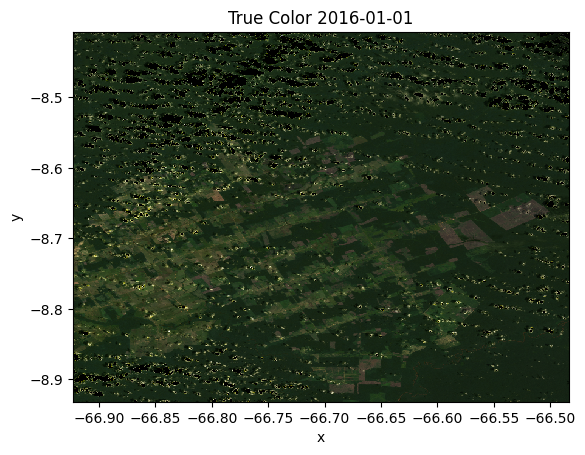

In [35]:
#@title True Color

# Get RGB data 15for a year
time = np.datetime64('2016-01-01')
true_color = ds_s2.sel(time = time)[["R", "G", "B"]].to_array()
# Divide by scale factor and apply gamma to brighten image
(true_color * 4).plot.imshow()
plt.title(f"True Color {time}");

**NDVI and Deforestation**

Now, we can also check how NDVI changes month-by-month, to identify any trends or regional clusters. Normal NDVI data exists within [0..1] range.

Studies usually argue about the appropriate NDVI threshold for dense vegetation, but generally values of 0.6~1.0 are considered a dense forest. Thus, if some pixel used to have such value and then dropped below treshold, we can suspect deforestation taking place.

!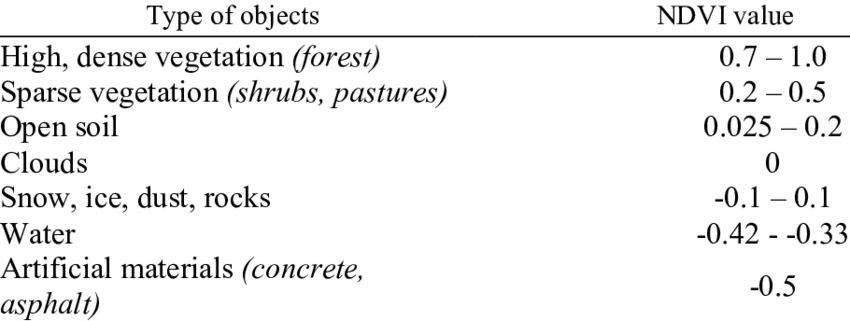

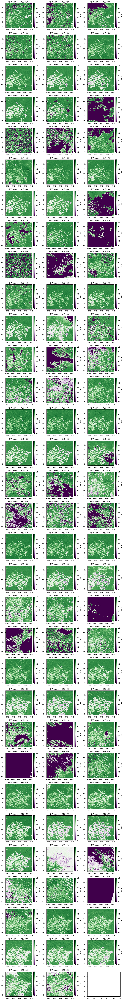

In [37]:
#@title NDVI Values

import matplotlib.pyplot as plt
import xarray as xr
import numpy as np

num_cols = 3  # Fixed number of columns
num_rows = int(np.ceil(len(ds_s2.time.values) / num_cols))

# Adjust figure height based on the number of rows
fig_height = 3 * num_rows  # Assuming 6 units of height per row
fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, fig_height))

# Flatten the axes array for easier iteration
axes_flat = axes.flatten()

for i, time in enumerate(ds_s2.time.values):
    # Check if we have more subplots than time values, and hide extra subplots
    if i >= len(axes_flat):
        break  # Stop if we've used all available subplots

    ax = axes_flat[i]
    ds_s2.sel(time=time).NDVI.plot(ax=ax, cmap="PRGn", vmin=0, vmax=1)

    # Convert numpy.datetime64 to datetime.datetime before using strftime
    time_str = str(time)[:10]  # Extract YYYY-MM-DD from the string representation
    ax.set_title(f"NDVI Values: {time_str}")
    ax.set_xlabel("")
    ax.set_ylabel("")

plt.tight_layout()
plt.show()

**Quantifying Deforestation**

From what we can see, there clearly are areas where over the years NDVI decreases in a somewhat organized fashion. To make sure, let's create a new band called FOREST which is binary coded (1 if NDVI > 0.6, 0 if not). Generally, this provides about 80% accuracy compared to validation dataset, so it is a good start to capture spatiotemporal trends.

To determine the annual forest cover, we can compile all monthly data available in each year, classify forest in it and estimate mean value of FOREST per pixel. For instance, if some pixel had FOREST values of **[0 0 1 1 NaN 1 NaN]*, it means that this year its FOREST value is 1.

Then, comparison between two years is rather trivial where we subtract one forest map from the other and color-code the change. It can take three possible values: -1 (deforested), 0 (no change), +1 (forest gained).

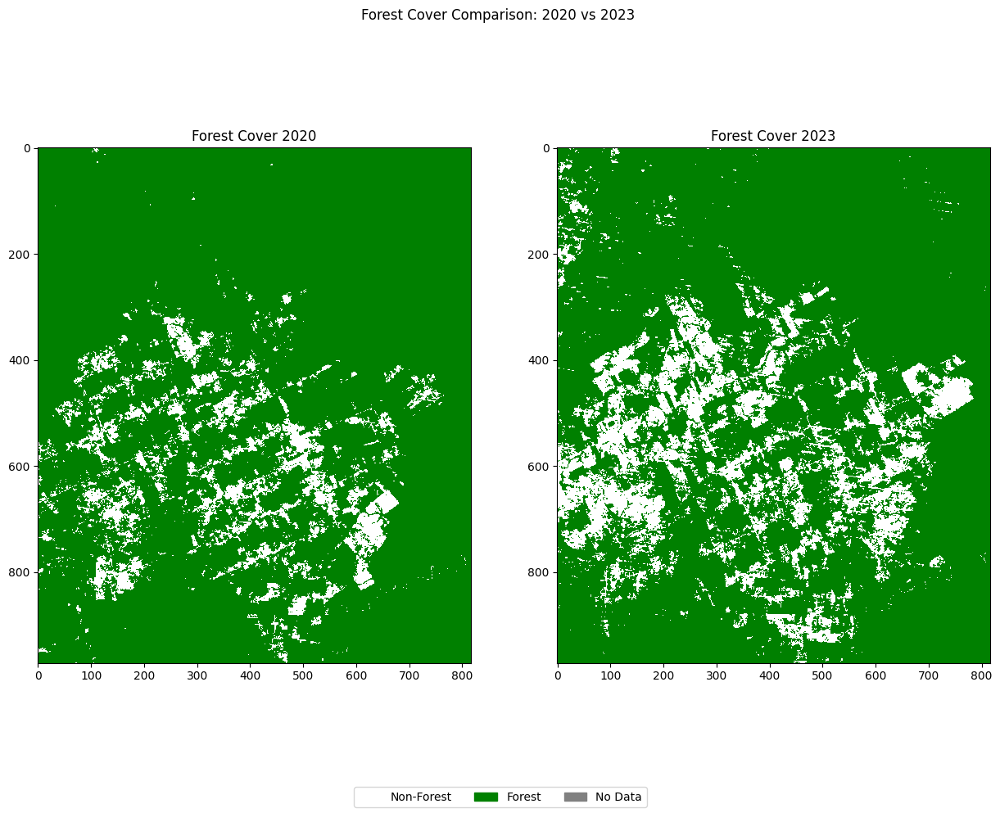

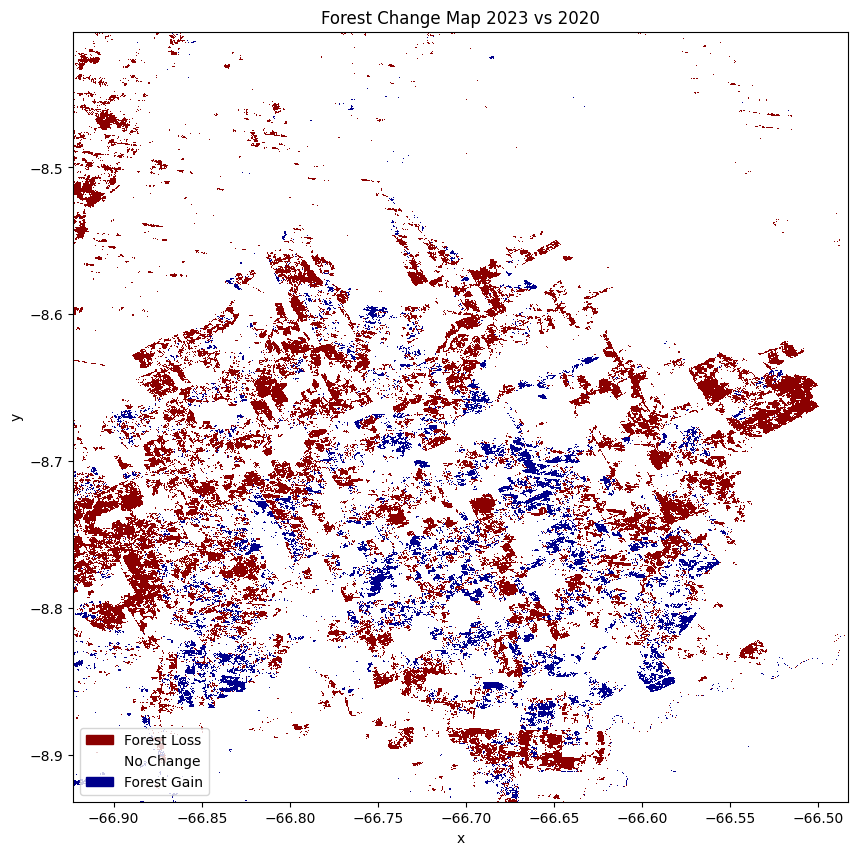

In [85]:
#@title Forest Cover change (masked)
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches

# Define the cloud value
CLOUD_VALUE = 0

# Step 1: Calculate Monthly FOREST by ignoring cloud-covered NDVI values
def calculate_monthly_forest(ds):
    """Determine forest cover (0 or 1) for each month based on NDVI threshold,
       ignoring cloud-covered values."""
    # Mask out cloud-covered values for NDVI calculations
    valid_ndvi = ds.NDVI.where(ds.NDVI != CLOUD_VALUE)

    # Determine forest presence for each month based on threshold (ignoring clouds)
    forest = xr.where(valid_ndvi > 0.60, 1, 0).astype(int)
    return forest

# Add monthly FOREST data to the dataset
ds_s2["FOREST"] = calculate_monthly_forest(ds_s2)

# Step 2: Calculate Annual FOREST by averaging non-cloud monthly values
def calculate_annual_forest(ds, min_valid_months=1):
    """Calculate annual forest status by averaging only non-negative monthly NDVI values,
       retaining tiles with a minimum number of valid observations."""

    # Retain all NDVI values >= 0, marking clouds as NaN for yearly average
    non_negative_ndvi = ds.NDVI.where(ds.NDVI >= 0)

    # Count valid (non-cloudy) months per year
    valid_months_per_year = non_negative_ndvi.groupby("time.year").count(dim="time")

    # Calculate annual mean of non-cloudy values only, ignoring NaNs
    annual_forest = non_negative_ndvi.groupby("time.year").mean(dim="time", skipna=True)

    # Apply minimum valid month threshold; NaN where insufficient data
    annual_forest = annual_forest.where(valid_months_per_year >= min_valid_months)

    # Classify forest cover: 1 for forest, 0 for non-forest, leave NaN for insufficient data
    return xr.where(annual_forest > 0.55, 1, 0).astype("float32")

# Calculate annual forest status for each year with a minimum valid month threshold
annual_forest = calculate_annual_forest(ds_s2, min_valid_months=1)

# Step 3: Calculate CHANGE between 2023 and 2020
def calculate_change(annual_forest):
    """Calculate the forest change between 2023 and 2020."""
    # Select the forest status for 2023 and 2020
    forest_end = annual_forest.sel(year=2023)
    forest_start = annual_forest.sel(year=2020)

    # Calculate change: 1 for gain, -1 for loss, 0 for no change
    change = (forest_end - forest_start).clip(-1, 1)

    return change

# Calculate forest change between 2023 and 2020
forest_change = calculate_change(annual_forest)

# Define colors and labels for forest cover with No Data shown in gray
forest_colors = ["white", "green", "gray"]
forest_labels = ["Non-Forest", "Forest", "No Data"]
forest_cmap = mcolors.ListedColormap(forest_colors)
forest_bounds = [0, 0.5, 1.5, 2]
forest_norm = mcolors.BoundaryNorm(forest_bounds, forest_cmap.N)

# Replace NaNs with 2 to display as "No Data" in gray
annual_forest_filled_2020 = annual_forest.sel(year=2020).where(~annual_forest.sel(year=2020).isnull(), other=2)
annual_forest_filled_2023 = annual_forest.sel(year=2023).where(~annual_forest.sel(year=2023).isnull(), other=2)

# Plot 2020 and 2023 forest cover side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
im1 = ax1.imshow(annual_forest_filled_2020, cmap=forest_cmap, norm=forest_norm)
ax1.set_title("Forest Cover 2020")

im2 = ax2.imshow(annual_forest_filled_2023, cmap=forest_cmap, norm=forest_norm)
ax2.set_title("Forest Cover 2023")

# Create a legend for forest cover
legend_patches = [
    mpatches.Patch(color=color, label=label) for color, label in zip(forest_colors, forest_labels)
]
fig.legend(handles=legend_patches, loc="lower center", ncol=3)
plt.suptitle("Forest Cover Comparison: 2020 vs 2023")
plt.show()

# Step 4: Plot the Forest Change Map
# Define custom colors and labels for change map
change_colors = ["darkred", "white", "darkblue"]
change_labels = ["Forest Loss", "No Change", "Forest Gain"]
change_cmap = mcolors.ListedColormap(change_colors)
change_norm = plt.Normalize(-1, 1)

# Plot the forest change map with custom legend
fig, ax = plt.subplots(figsize=(10, 10))
im3 = forest_change.plot(cmap=change_cmap, norm=change_norm, add_colorbar=False, ax=ax)

# Create a legend for the change map
change_legend_patches = [
    mpatches.Patch(color=color, label=label) for color, label in zip(change_colors, change_labels)
]
ax.legend(handles=change_legend_patches, loc="lower left")
ax.set_title("Forest Change Map 2023 vs 2020")
plt.show()


We can also overlay our change over true color data and outline it so we can actually see where different clusters are.

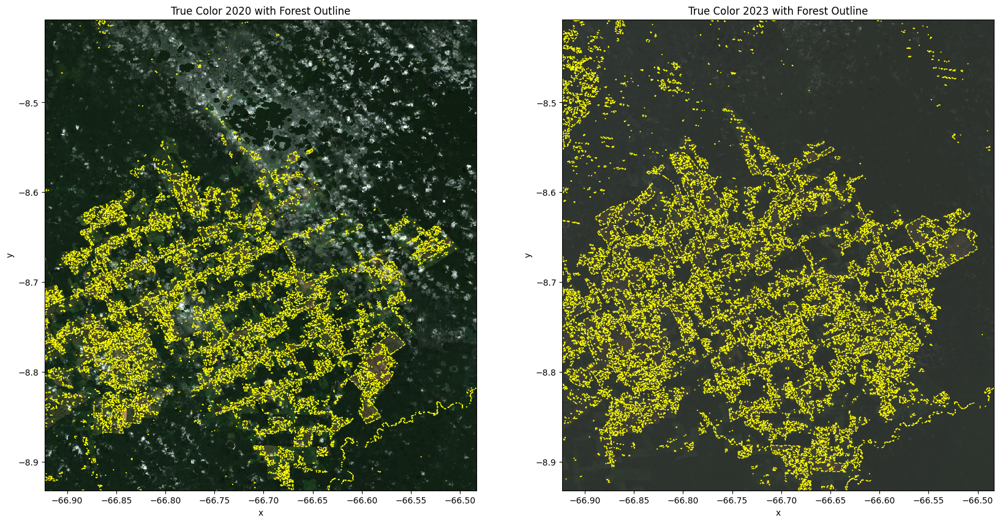

In [55]:
#@title True Color Forest Change

import xarray as xr
import numpy as np
import matplotlib.pyplot as plt

# Define the cloud value
CLOUD_VALUE = 0

# Step 1: Calculate Monthly FOREST by ignoring cloud-covered NDVI values
def calculate_monthly_forest(ds):
    """Determine forest cover (0 or 1) for each month based on NDVI threshold,
       ignoring cloud-covered values."""
    # Mask out cloud-covered values for NDVI calculations
    valid_ndvi = ds.NDVI.where(ds.NDVI != CLOUD_VALUE)

    # Determine forest presence for each month based on threshold (ignoring clouds)
    forest = xr.where(valid_ndvi > 0.55, 1, 0).astype(int)
    return forest

# Add monthly FOREST data to the dataset
ds_s2["FOREST"] = calculate_monthly_forest(ds_s2)

# Step 2: Calculate Annual FOREST by averaging non-cloud monthly values
def calculate_annual_forest(ds, min_valid_months=1):
    """Calculate annual forest status by averaging only non-negative monthly NDVI values,
       retaining tiles with a minimum number of valid observations."""

    # Retain all NDVI values >= 0, marking clouds as NaN for yearly average
    non_negative_ndvi = ds.NDVI.where(ds.NDVI >= 0)

    # Count valid (non-cloudy) months per year
    valid_months_per_year = non_negative_ndvi.groupby("time.year").count(dim="time")

    # Calculate annual mean of non-cloudy values only, ignoring NaNs
    annual_forest = non_negative_ndvi.groupby("time.year").mean(dim="time", skipna=True)

    # Apply minimum valid month threshold; NaN where insufficient data
    annual_forest = annual_forest.where(valid_months_per_year >= min_valid_months)

    # Classify forest cover: 1 for forest, 0 for non-forest, leave NaN for insufficient data
    return xr.where(annual_forest > 0.55, 1, 0).astype("float32")



# Step 3: Find the least cloudy time for the year
def find_least_cloudy_time(ds, year):
    """
    Find the least cloudy time for the given year.
    Assumes the NDVI layer has a value of -3.2768 for cloudy pixels.
    """
    year_start = f"{year}-01-01"
    year_end = f"{year}-12-31"
    time_slices = ds.sel(time=slice(year_start, year_end))

    # Find the time slice with the minimum number of cloudy pixels
    cloud_mask = time_slices["NDVI"] == CLOUD_VALUE
    least_cloudy_index = cloud_mask.sum(axis=(1, 2)).argmin().compute()

    # Access the time value using the index
    least_cloudy_time = time_slices.time[least_cloudy_index].values
    return least_cloudy_time


# Calculate annual forest status for each year with a minimum valid month threshold
annual_forest = calculate_annual_forest(ds_s2, min_valid_months=1)

# Plot side-by-side true color images for 2022 and 2023 with forest outlines
def plot_true_color_side_by_side(ds, forest_data, year1, year2):
    """Plot True Color images for two specified years side-by-side with forest outlines."""
    least_cloudy_time1 = find_least_cloudy_time(ds, year1)
    least_cloudy_time2 = find_least_cloudy_time(ds, year2)

    # Convert time to nanosecond precision
    least_cloudy_time1 = np.datetime64(least_cloudy_time1, "ns")
    least_cloudy_time2 = np.datetime64(least_cloudy_time2, "ns")

    true_color1 = ds.sel(time=least_cloudy_time1)[["R", "G", "B"]].to_array()
    true_color2 = ds.sel(time=least_cloudy_time2)[["R", "G", "B"]].to_array()

    # Normalize the RGB values to [0, 1] for proper plotting
    true_color1_scaled = (true_color1 * 4).clip(0, 1)
    true_color2_scaled = (true_color2 * 1.5).clip(0, 1)

    # Set up side-by-side subplots
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    # Plot for year 1
    ax1 = axes[0]
    true_color1_scaled.plot.imshow(ax=ax1)
    forest_data.sel(year=year1).plot.contour(ax=ax1, levels=[0.5], colors=['yellow'], linestyles="--", linewidths=1)
    ax1.set_title(f"True Color {year1} with Forest Outline")

    # Plot for year 2
    ax2 = axes[1]
    true_color2_scaled.plot.imshow(ax=ax2)
    forest_data.sel(year=year2).plot.contour(ax=ax2, levels=[0.5], colors=['yellow'], linestyles="--", linewidths=1)
    ax2.set_title(f"True Color {year2} with Forest Outline")

    plt.show()

# Plot the True Color side-by-side for 2022 and 2023
plot_true_color_side_by_side(ds_s2, annual_forest, 2020, 2023)


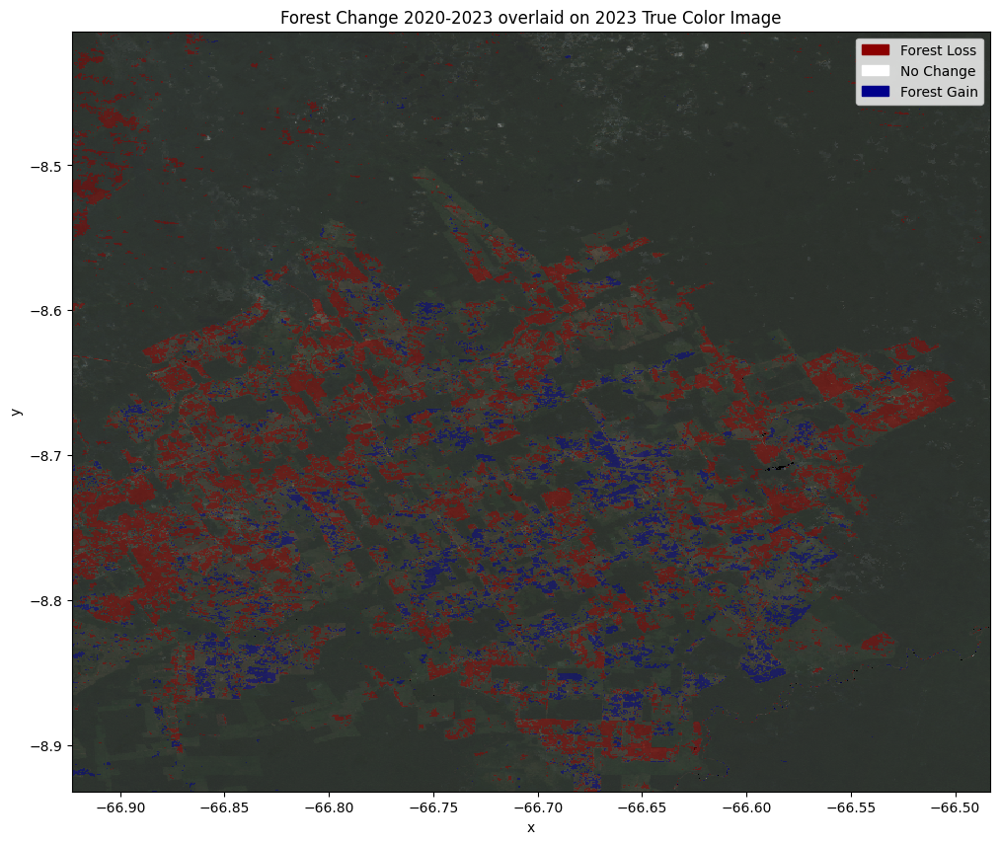

In [74]:
#@title True Color Forest Change

import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches

# Define the cloud value
CLOUD_VALUE = 0

# Step 1: Calculate Monthly FOREST by ignoring cloud-covered NDVI values
def calculate_monthly_forest(ds):
    """Determine forest cover (0 or 1) for each month based on NDVI threshold,
       ignoring cloud-covered values."""
    # Mask out cloud-covered values for NDVI calculations
    valid_ndvi = ds.NDVI.where(ds.NDVI != CLOUD_VALUE)

    # Determine forest presence for each month based on threshold (ignoring clouds)
    forest = xr.where(valid_ndvi > 0.55, 1, 0).astype(int)
    return forest

# Add monthly FOREST data to the dataset
ds_s2["FOREST"] = calculate_monthly_forest(ds_s2)

# Step 2: Calculate Annual FOREST by averaging non-cloud monthly values
def calculate_annual_forest(ds, min_valid_months=1):
    """Calculate annual forest status by averaging only non-negative monthly NDVI values,
       retaining tiles with a minimum number of valid observations."""

    # Retain all NDVI values >= 0, marking clouds as NaN for yearly average
    non_negative_ndvi = ds.NDVI.where(ds.NDVI >= 0)

    # Count valid (non-cloudy) months per year
    valid_months_per_year = non_negative_ndvi.groupby("time.year").count(dim="time")

    # Calculate annual mean of non-cloudy values only, ignoring NaNs
    annual_forest = non_negative_ndvi.groupby("time.year").mean(dim="time", skipna=True)

    # Apply minimum valid month threshold; NaN where insufficient data
    annual_forest = annual_forest.where(valid_months_per_year >= min_valid_months)

    # Classify forest cover: 1 for forest, 0 for non-forest, leave NaN for insufficient data
    return xr.where(annual_forest > 0.55, 1, 0).astype("float32")


# Step 4: Calculate CHANGE between 2023 and 2022
def calculate_change(annual_forest):
    """Calculate the forest change between 2023 and 2020."""
    # Select the forest status for 2023 and 2022
    forest_end = annual_forest.sel(year=2023)
    forest_start = annual_forest.sel(year=2020)
    # Calculate change: -1 (loss), 0 (no change), 1 (gain)
    change = (forest_end - forest_start).clip(-1, 1)
    return change

# Calculate annual forest status
annual_forest = calculate_annual_forest(ds_s2, min_valid_months=1)

# Calculate forest change between the two years
forest_change = calculate_change(annual_forest)

# Step 5: Find the least cloudy time for 2023 and retrieve RGB data for that time
time_end = find_least_cloudy_time(ds_s2, 2023)
rgb_data = ds_s2.sel(time=time_end)[["R", "G", "B"]].to_array()
rgb_scaled = (rgb_data * 1.5).clip(0, 1)

# Visualization
# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 10))

# Plot true color image for the least cloudy time of 2023
rgb_scaled.plot.imshow(ax=ax)

# Define custom colormap for forest change
change_colors = ["darkred", "white", "darkblue"]
change_cmap = mcolors.ListedColormap(change_colors)
change_norm = plt.Normalize(-1, 1)

# Plot forest change overlaid on true color image with transparency
forest_change.plot(
    ax=ax,
    cmap=change_cmap,
    norm=change_norm,
    alpha=np.where(forest_change == -1, 0.50, np.where(forest_change == 0, 0.0, 0.50)),
    levels=[-1.5, -0.5, 0.5, 1.5],
    extend='both',
    add_colorbar=False  # This line disables the colorbar
)

# Customize the plot
ax.set_title("Forest Change 2020-2023 overlaid on 2023 True Color Image")

# Add a custom legend for forest change
change_legend_patches = [
    mpatches.Patch(color=color, label=label) for color, label in zip(change_colors, ["Forest Loss", "No Change", "Forest Gain"])
]
ax.legend(handles=change_legend_patches, loc='upper right')

plt.show()
